In [2]:
from pathlib import Path

base_path = Path('/data')





In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt10
import seaborn as sns 
import warnings
warnings.filterwarnings("ignore")
import tqdm
import os

import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('ggplot')

In [9]:
from itables import init_notebook_mode
init_notebook_mode(all_interactive=True)

<IPython.core.display.Javascript object>

In [10]:
data = pd.read_csv('data/results_CLIP_sep.csv')
data.head()

Unnamed: 0                        id                               topics  \
0           0  5fd0252a04167a0cab36b005  adding spices to food while cooking   
1           1  5fd0252a04167a0cab36b005                               spices   
2           2  5fd0315af2d9500e4358b0c7  adding spices to food while cooking   
3           3  5fd0315af2d9500e4358b0c7                               spices   
4           4  5fd02cf0a8444d0db97b468e  adding spices to food while cooking   

   income  CLIP score region.id    country.name  \
0  1034.0    0.315204        am          Brazil   
1  1034.0    0.253499        am          Brazil   
2  5237.0    0.233253        eu  Czech Republic   
3  5237.0    0.184958        eu  Czech Republic   
4   654.0    0.258482        am        Colombia   

                                        imageRelPath quartile          bin  
0  assets/5fd0252a04167a0cab36b005/c50ecfe03cc6dc...   up-mid   e_800-1600  
1  assets/5fd0252a04167a0cab36b005/c50ecfe03cc6dc...   up-mid   e_800-1600  
2  assets/5fd0315af2d9500e4358b0c7/0a39ce20596cf7...     rich  g_3200-6400  
3  assets/5fd0315af2d9500e4358b0c7/0a39ce20596cf7...     rich  g_3200-6400  
4  assets/5fd02cf0a8444d0db97b468e/fbfe44d3529086...  low-mid    d_400-800

In [11]:
data['topics'].nunique()

270

In [12]:
# map each image to corresponding topics, countries, income level ... TODO
dict_id2country, dict_id2path = {}, {}
for image_path, country, id_ in zip(data['imageRelPath'], data['country.name'], data['id']):
    dict_id2path[id_] = image_path
    dict_id2country[id_] = country
    

#print(len(dict_img2topic))
print(dict_id2path)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [15]:
dict_name2path = {}
dict_name2id = {}

for topic in data['topics'].unique():
    for country in data['country.name'].unique():
        for quartile in data['quartile'].unique():
            impath = data.loc[(data["topics"] == topic) & (data["country.name"] == country) & (data["quartile"] == quartile), "imageRelPath"].values
            i_d = data.loc[(data["topics"] == topic) & (data["country.name"] == country) & (data["quartile"] == quartile), "id"].values
            name = str(topic) + '_' + str(country) + '_' + str(quartile)
            dict_name2path[name] = impath
            dict_name2id[name] = i_d
            

In [10]:

#create a binary pickle file 
f = open("data/dict_name2path.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(dict_name2path,f)

# close file
f.close()

In [11]:
#create a binary pickle file 
f = open("data/dict_name2id.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(dict_name2id,f)

# close file
f.close()

In [78]:
path_data = '/nfs/turbo/coe-mihalcea/shared_data/dollarstreet'
path_processed_images = "/".join([path_data, "processed_imgs"])
path_original_images = "/nfs/turbo/coe-mihalcea/shared_data/dollarstreet"

In [41]:
import numpy as np
import torch
import tqdm
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)
torch.cuda.empty_cache()

cuda


In [44]:
import clip

model, preprocess = clip.load("ViT-B/32")
model.cuda().eval()

CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          

In [ ]:
dict_name2imgfeature = {}

for name in dict_name2id.keys():
    processed_images = [path_processed_images + "/" + img_id + ".npy" for img_id in dict_name2id[name]]
    images_prep = []
    for image_path in tqdm.tqdm(processed_images):
        if Path(image_path).is_file():         
            images_prep.append(torch.from_numpy(np.load(image_path)).to(device))
        else:
            imgs_corrupted.append(image_path)
            print(f"{image_path} corrupted")
    if images_prep != []:       
        images_prep = torch.stack(images_prep)
        torch.cuda.empty_cache()
    
        with torch.no_grad():
            image_features = model.encode_image(images_prep)
            image_features /= image_features.norm(dim=-1, keepdim=True)
        
        dict_name2imgfeature[name] = image_features
    

In [36]:
#create a binary pickle file 
f = open("dict_name2imgfeature.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(dict_name2imgfeature,f)

# close file
f.close()

### Create Avg features dictionary

In [17]:
dict_name2avg_features = {}

for name in dict_name2imgfeature:
    average_embed = torch.mean(dict_name2imgfeature[name], dim=0)
    dict_name2avg_features[name] = average_embed
    


In [19]:
dict_name2avg_features['adding spices to food while cooking_India_rich'].shape

torch.Size([512])

In [20]:
#create a binary pickle file 
f = open("dict_name2avg_features.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(dict_name2avg_features,f)

# close file
f.close()

In [18]:
# load pickle module


file_to_read = open("data/dict_name2avg_features.pkl", "rb")

dict_name2avg_features = pickle.load(file_to_read)

In [21]:
len(dict_name2avg_features.keys())

15385

## Analogy Checker

In [65]:
device = "cuda" if torch.cuda.is_available() else "cpu"
model = clip.load("ViT-B/32", device=device)[0]
templates = [
    'an image of {}.',
]

In [66]:
cos = torch.nn.CosineSimilarity(dim=0)


topic_query = "toilet"
country_query = "Nigeria"
income_level = "poor"
emb_query = dict_name2avg_features["_".join([topic_query, country_query, income_level])]

list_similarities = []

for text, vis_emb in dict_name2avg_features.items():
    text = text.replace("bed_hq", "bed-hq")
    topic, country, income = text.split("_")
    if topic != topic_query and country != country_query and income == "rich":
#     if country == country_query:
#         similarity = emb_query.cpu().numpy() @ vis_emb.cpu().numpy().T
        similarity = cos(emb_query, vis_emb)
        list_similarities.append([topic, country, similarity, income])


list_similarities.sort(key=lambda x: x[2], reverse=True)        
print(list_similarities[:10])
    

[['backyard', 'China', tensor(0.8882, device='cuda:0', dtype=torch.float16), 'rich'], ['agriculture land', 'Czech Republic', tensor(0.8813, device='cuda:0', dtype=torch.float16), 'rich'], ['vegetable plot', 'China', tensor(0.8730, device='cuda:0', dtype=torch.float16), 'rich'], ['play area', 'Ukraine', tensor(0.8540, device='cuda:0', dtype=torch.float16), 'rich'], ['fruit trees', 'Czech Republic', tensor(0.8506, device='cuda:0', dtype=torch.float16), 'rich'], ['street detail', 'Mexico', tensor(0.8467, device='cuda:0', dtype=torch.float16), 'rich'], ['vegetable plot', 'Nepal', tensor(0.8394, device='cuda:0', dtype=torch.float16), 'rich'], ['fruit trees', 'France', tensor(0.8384, device='cuda:0', dtype=torch.float16), 'rich'], ['street detail', 'Ukraine', tensor(0.8359, device='cuda:0', dtype=torch.float16), 'rich'], ['wall', 'United States', tensor(0.8340, device='cuda:0', dtype=torch.float16), 'rich']]


Topic: toilet, Country:Nigeria, Income: poor


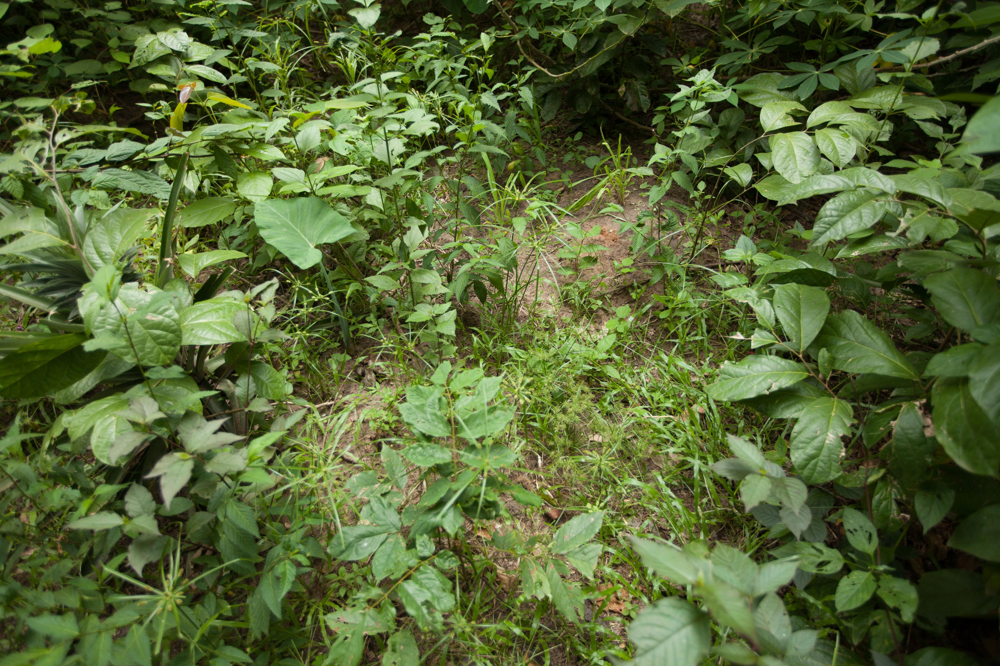

Topic: toilet, Country:Nigeria, Income: poor


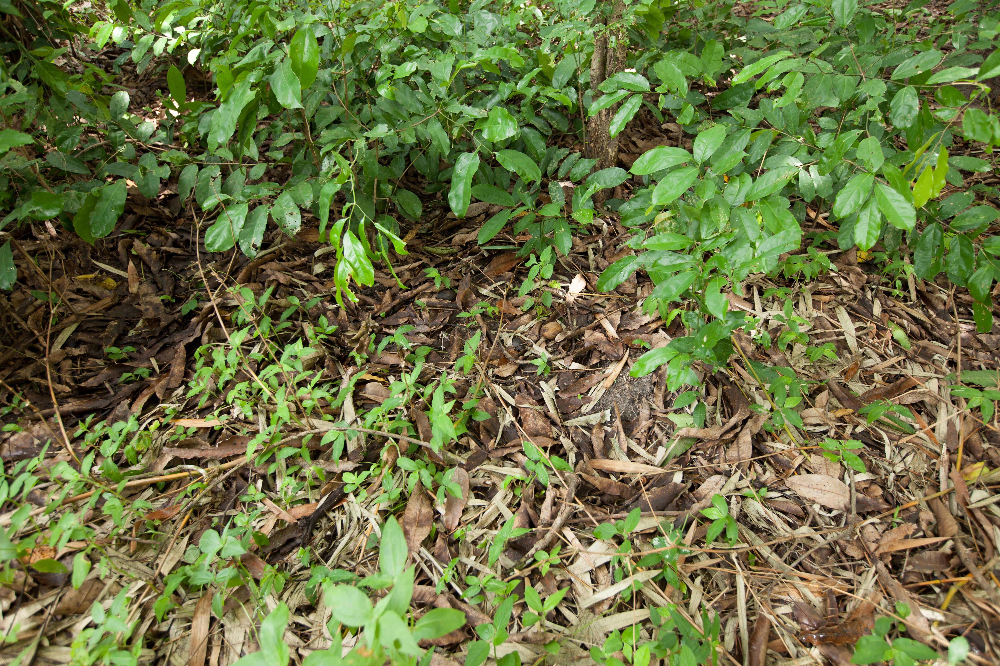

Topic: toilet, Country:Nigeria, Income: poor


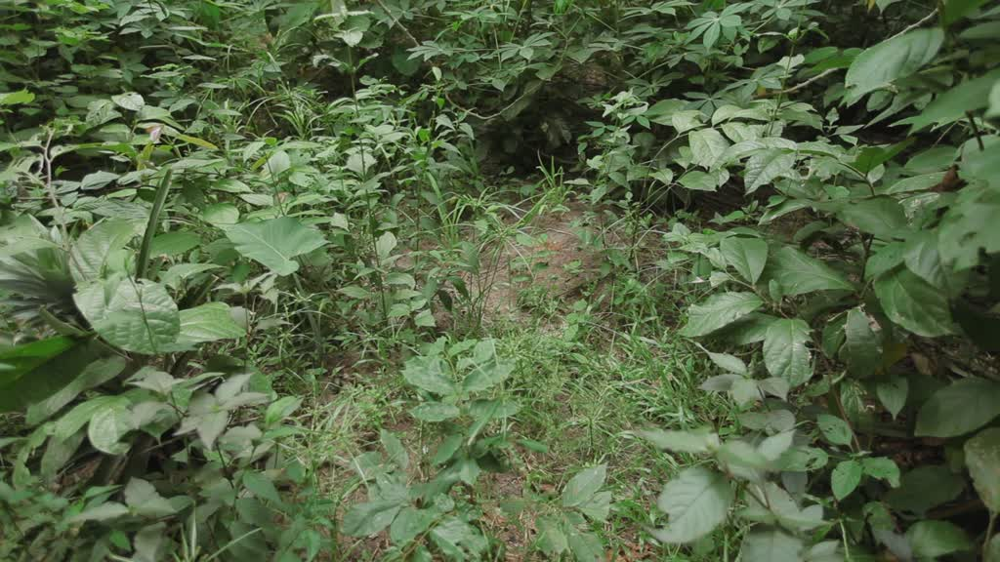

Topic: toilet, Country:Nigeria, Income: poor


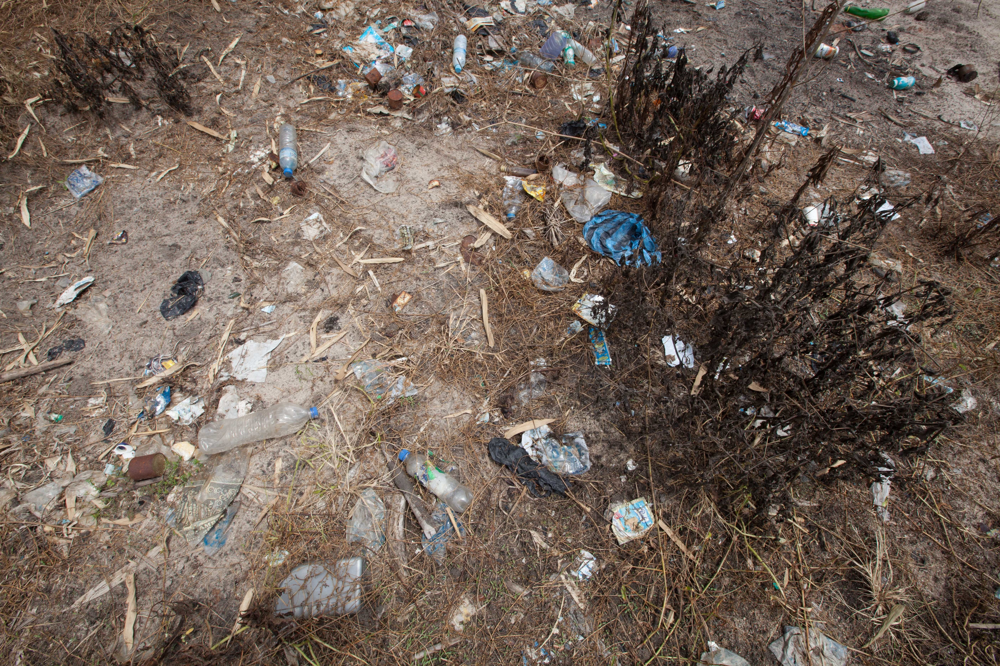

Topic: toilet, Country:Nigeria, Income: poor


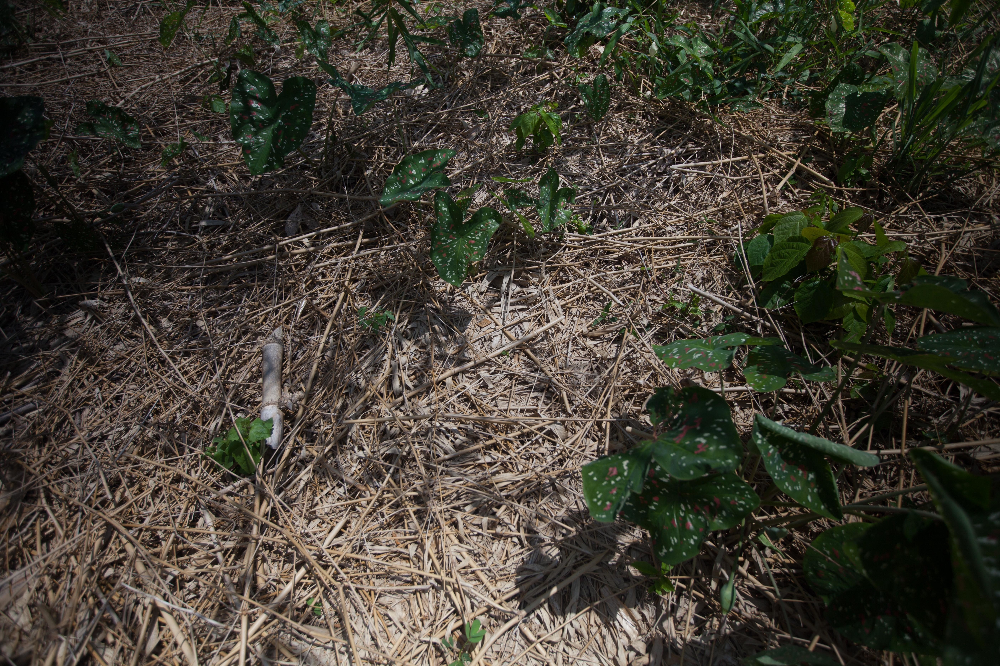

Topic: toilet, Country:Nigeria, Income: poor


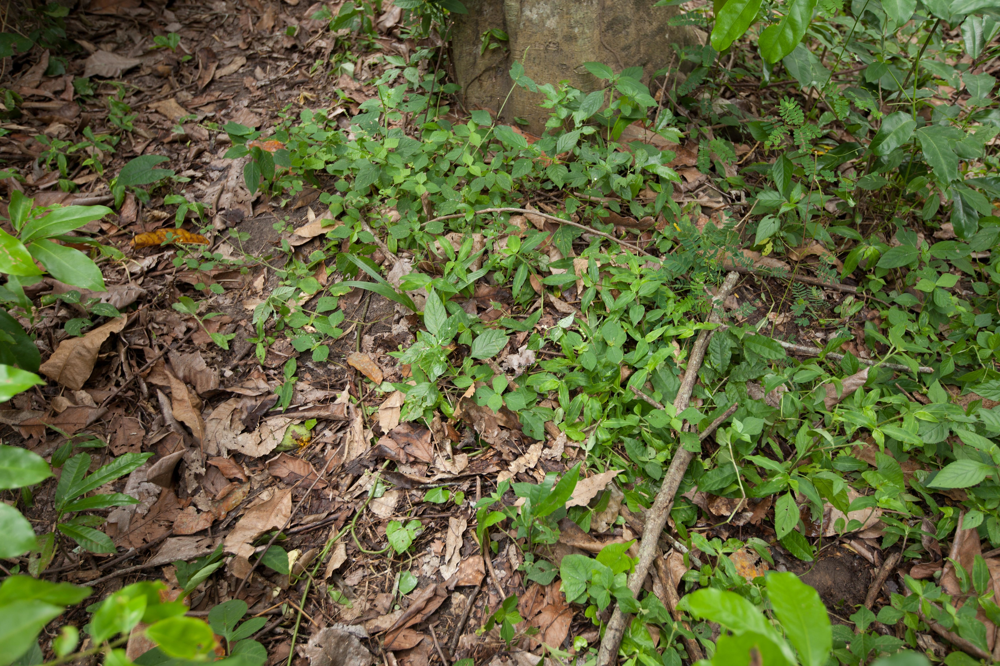

Topic: toilet, Country:Nigeria, Income: poor


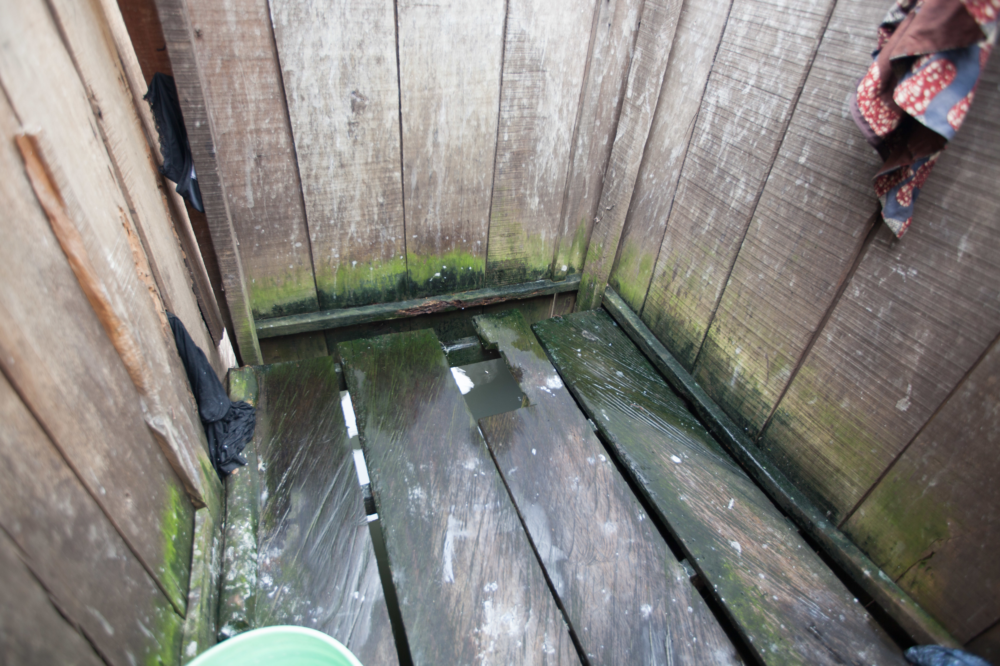

Topic: toilet, Country:Nigeria, Income: poor


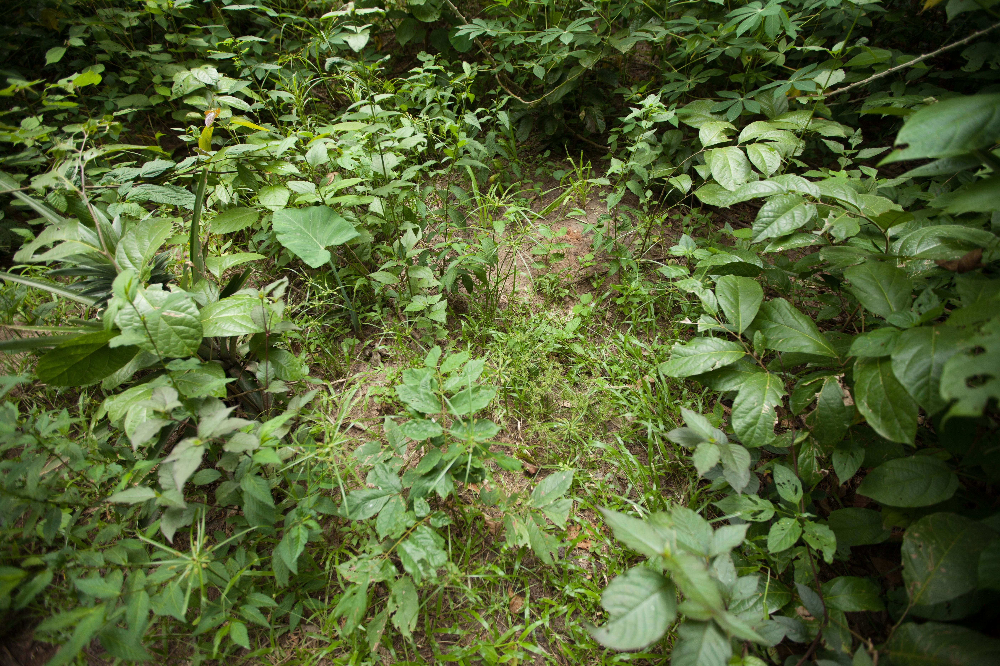

Topic: toilet, Country:Nigeria, Income: poor


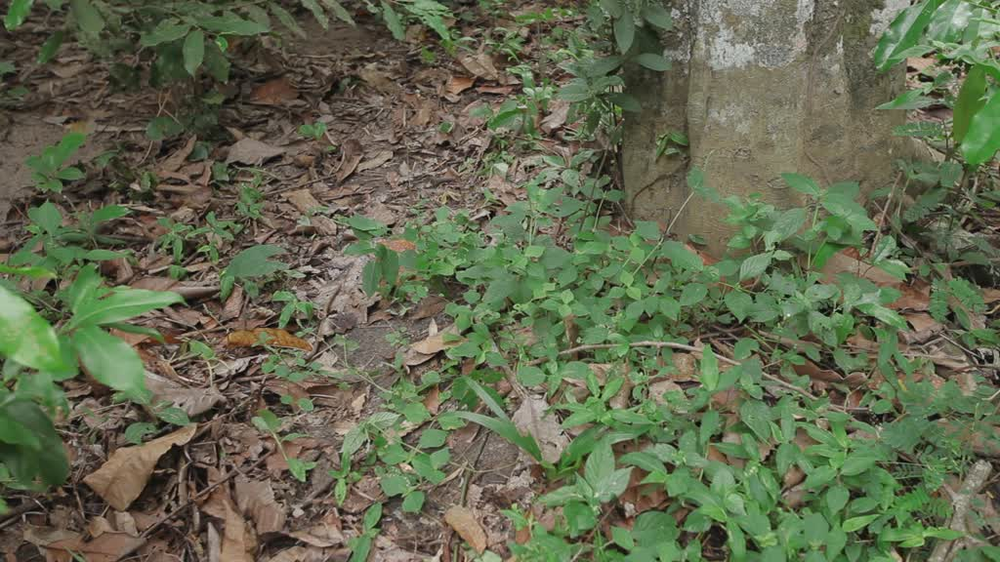

In [80]:
import PIL.Image
import os
from IPython.display import Image, display

topic_query = "toilet"
country_query = "Nigeria"
income_query = 'poor'

nb_imgs_max = 10
for [image_name, income, country, topic] in results_df[['imageRelPath', 'quartile', 'country.name', 'topics']].values.tolist():
    if topic_query == topic.lower() and income == income_query and country == country_query:
        imageName = "/".join([path_original_images, image_name])
        #print(imageName)
        if os.path.exists(imageName):
            Img = PIL.Image.open(imageName)
            print(f"Topic: {topic}, Country:{country}, Income: {income}")
            display(Image(filename=imageName, width=300))
            nb_imgs_max -=1
        if not nb_imgs_max:
            break

## Plot Heatmap

In [28]:
import numpy as np
import torch
from pkg_resources import packaging
from PIL import Image
print("Torch version:", torch.__version__)
from tqdm import tqdm
cos = torch.nn.CosineSimilarity(dim=0)
from sklearn.metrics.pairwise import cosine_similarity

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import pyplot

Torch version: 1.10.2+cu113


In [25]:

income_level = ['poor', 'rich']

countries = ['Nigeria', 'Colombia', 'India']
topics = ['toilet', 'backyard', 'bed', 'floor']

dict_emb = {}
for income_query in income_level: 
    for topic_query in topics:
        for country_query in countries:
            query = "_".join([topic_query, country_query, income_query])
            if query not in dict_name2avg_features:
                print(query)
                continue
            emb_query = dict_name2avg_features[query]
            query = query.replace('_', ' ')
            query = query.replace('poor', '$')
            query = query.replace('rich', '$$$')
#             query = query.replace('India', 'AA1')
#             query = query.replace('Nigeria', 'AA2')
#             query = query.replace('Colombia', 'AA3')
            dict_emb[query] = emb_query

list_sim = []
for key1, emb1 in dict_emb.items():
    list_sim1 = []
    for key2, emb2 in dict_emb.items():
        sim = cos(emb1, emb2).cpu().numpy().item()
#         if sim >= 0.8:
#             sim = 1
#         else:
#             sim = 0
        list_sim1.append(round(sim,2))
    list_sim.append(list_sim1)

print(len(dict_emb.keys()), len(list_sim))
df = pd.DataFrame(list_sim, index=dict_emb.keys(), columns=dict_emb.keys())
df

backyard_Nigeria_rich
23 23


toilet Nigeria $  toilet Colombia $  toilet India $  \
toilet Nigeria $                   1.00               0.78            0.90   
toilet Colombia $                  0.78               1.00            0.85   
toilet India $                     0.90               0.85            1.00   
backyard Nigeria $                 0.82               0.77            0.91   
backyard Colombia $                0.84               0.78            0.85   
backyard India $                   0.83               0.76            0.88   
bed Nigeria $                      0.78               0.79            0.86   
bed Colombia $                     0.81               0.83            0.86   
bed India $                        0.82               0.80            0.88   
floor Nigeria $                    0.85               0.74            0.82   
floor Colombia $                   0.89               0.80            0.87   
floor India $                      0.85               0.78            0.83   
toilet Nigeria $$$                 0.71               0.84            0.76   
toilet Colombia $$$                0.67               0.83            0.70   
toilet India $$$                   0.71               0.87            0.76   
backyard Colombia $$$              0.78               0.68            0.75   
backyard India $$$                 0.79               0.71            0.81   
bed Nigeria $$$                    0.68               0.70            0.67   
bed Colombia $$$                   0.63               0.61            0.65   
bed India $$$                      0.73               0.70            0.79   
floor Nigeria $$$                  0.75               0.71            0.76   
floor Colombia $$$                 0.77               0.70            0.74   
floor India $$$                    0.75               0.70            0.75   

                       backyard Nigeria $  backyard Colombia $  \
toilet Nigeria $                     0.82                 0.84   
toilet Colombia $                    0.77                 0.78   
toilet India $                       0.91                 0.85   
backyard Nigeria $                   1.00                 0.86   
backyard Colombia $                  0.86                 1.00   
backyard India $                     0.88                 0.81   
bed Nigeria $                        0.89                 0.81   
bed Colombia $                       0.82                 0.80   
bed India $                          0.82                 0.78   
floor Nigeria $                      0.72                 0.73   
floor Colombia $                     0.78                 0.81   
floor India $                        0.75                 0.77   
toilet Nigeria $$$                   0.66                 0.68   
toilet Colombia $$$                  0.59                 0.60   
toilet India $$$                     0.63                 0.63   
backyard Colombia $$$                0.63                 0.68   
backyard India $$$                   0.73                 0.73   
bed Nigeria $$$                      0.59                 0.64   
bed Colombia $$$                     0.61                 0.57   
bed India $$$                        0.72                 0.67   
floor Nigeria $$$                    0.64                 0.65   
floor Colombia $$$                   0.62                 0.63   
floor India $$$                      0.62                 0.63   

                       backyard India $  bed Nigeria $  bed Colombia $  \
toilet Nigeria $                   0.83           0.78            0.81   
toilet Colombia $                  0.76           0.79            0.83   
toilet India $                     0.88           0.86            0.86   
backyard Nigeria $                 0.88           0.89            0.82   
backyard Colombia $                0.81           0.81            0.80   
backyard India $                   1.00           0.87            0.86   
bed Nigeria $                      0.87        

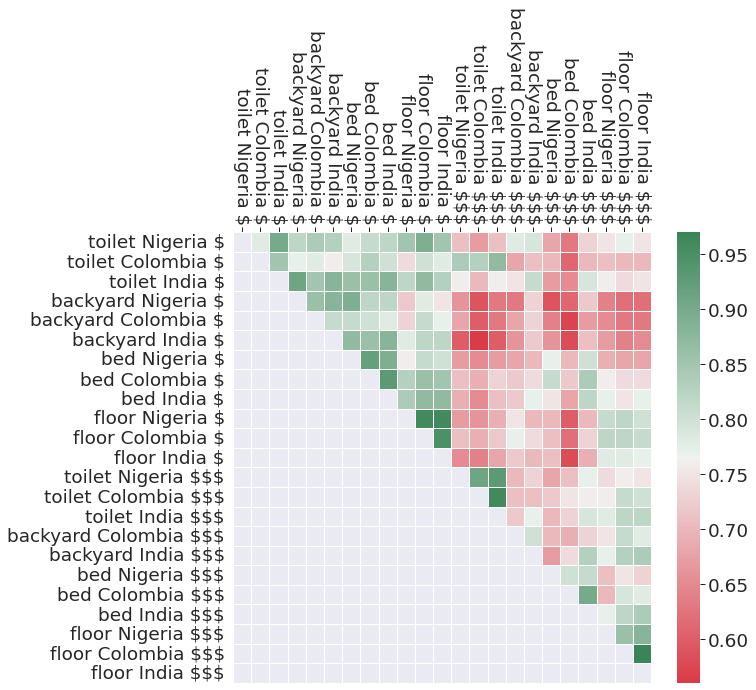

In [30]:
# from matplotlib.colors import LinearSegmentedColormap
# Create a mask
mask = np.tril(np.ones_like(list_sim, dtype=bool))

a4_dims = (11, 10)
fig, ax = pyplot.subplots(figsize=a4_dims)
sns.set_theme(context='paper', font_scale=2.1)

cmap = sns.diverging_palette(10, 140, sep=1, l=50, center="light", as_cmap=True)
# color = ((0.8, 0.0, 0.0, 1.0), (0.0, 0.8, 0.0, 1.0))
# cmap = LinearSegmentedColormap.from_list('Custom', color, 2)
sns.heatmap(df, mask=mask, linewidth=0.9, cmap=cmap)
# sns.clustermap(df, mask=mask, linewidth=0.9, cmap=cmap)
ax.xaxis.tick_top()
plt.xticks(rotation=270)


# # Manually specify colorbar labelling after it's been generated
# colorbar = ax.collections[0].colorbar
# colorbar.set_ticks([0.7, 0.3])
# colorbar.set_ticklabels(['>=0.8', '<0.8'])

plt.tight_layout()
# plt.show()
plt.savefig('Images/heatmap.pdf', bbox_inches='tight')

## Extended Plot

In [36]:
ext_dict_name2path = {}
ext_dict_name2id = {}


for country in data['country.name'].unique():
    for quartile in data['quartile'].unique():
        impath = data.loc[(data["country.name"] == country) & (data["quartile"] == quartile), "imageRelPath"].values
        i_d = data.loc[(data["country.name"] == country) & (data["quartile"] == quartile), "id"].values
        name = str(country) + '_' + str(quartile)
        ext_dict_name2path[name] = impath
        ext_dict_name2id[name] = i_d


In [38]:
len(ext_dict_name2id)

252

In [45]:
extended_dict_name2imgfeature = {}

for name in ext_dict_name2id.keys():
    processed_images = [path_processed_images + "/" + img_id + ".npy" for img_id in ext_dict_name2id[name]]
    images_prep = []
    for image_path in tqdm.tqdm(processed_images):
        if Path(image_path).is_file():         
            images_prep.append(torch.from_numpy(np.load(image_path)).to(device))
        else:
            imgs_corrupted.append(image_path)
            print(f"{image_path} corrupted")
    if images_prep != []:       
        images_prep = torch.stack(images_prep)
        torch.cuda.empty_cache()
    
        with torch.no_grad():
            image_features = model.encode_image(images_prep)
            image_features /= image_features.norm(dim=-1, keepdim=True)
        
        extended_dict_name2imgfeature[name] = image_features

100%|██████████| 968/968 [00:30<00:00, 31.34it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
100%|██████████| 396/396 [00:13<00:00, 28.40it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
100%|██████████| 330/330 [00:10<00:00, 32.24it/s]
0it [00:00, ?it/s]
100%|██████████| 1172/1172 [00:34<00:00, 34.23it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
100%|██████████| 260/260 [00:07<00:00, 33.69it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
100%|██████████| 268/268 [00:08<00:00, 30.91it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
100%|██████████| 166/166 [00:05<00:00, 31.96it/s]
0it [00:00, ?it/s]
100%|██████████| 132/132 [00:03<00:00, 33.44it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
100%|██████████| 353/353 [00:09<00:00, 38.23it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
100%|██████████| 292/292 [00:06<00:00, 48.51it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
100%|██████████| 675/675 [00:19<00:00, 34.35it/s]
0it [00:00, ?it/s]
100%|██████████| 535/535 [00:14<00:00, 37.35it/s]

In [47]:
import pickle
#create a binary pickle file 
f = open("data/country_quart_dict_name2imgfeature.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(extended_dict_name2imgfeature,f)

# close file
f.close()

In [51]:
ext_dict_name2avg_features = {}

for name in extended_dict_name2imgfeature:
    average_embed = torch.mean(extended_dict_name2imgfeature[name], dim=0)
    ext_dict_name2avg_features[name] = average_embed

In [ ]:
#create a binary pickle file 
f = open("data/country_quart_dict_name2avg_features.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(dict_name2avg_features,f)

# close file
f.close()

In [53]:
len(ext_dict_name2avg_features.keys())

125

In [61]:
income_level = ['poor', 'rich']
countries = data['country.name'].unique().tolist()


dict_emb = {}
for income_query in income_level: 
    
    for country_query in countries:
        query = "_".join([country_query, income_query])
        if query not in ext_dict_name2avg_features:
            print(query)
            continue
        emb_query = ext_dict_name2avg_features[query]
        query = query.replace('_', ' ')
        query = query.replace('poor', '$')
        query = query.replace('rich', '$$$')

        dict_emb[query] = emb_query

list_sim = []
for key1, emb1 in dict_emb.items():
    list_sim1 = []
    for key2, emb2 in dict_emb.items():
        sim = cos(emb1, emb2).cpu().numpy().item()
#         if sim >= 0.8:
#             sim = 1
#         else:
#             sim = 0
        list_sim1.append(round(sim,2))
    list_sim.append(list_sim1)

#print(len(dict_emb.keys()), len(list_sim))
df = pd.DataFrame(list_sim, index=dict_emb.keys(), columns=dict_emb.keys())

Brazil_poor
Czech Republic_poor
Spain_poor
Italy_poor
Romania_poor
Sweden_poor
Iran_poor
Austria_poor
Serbia_poor
Netherlands_poor
Ethiopia_poor
Turkey_poor
Russia_poor
Switzerland_poor
Denmark_poor
United States_poor
Lebanon_poor
Vietnam_poor
Ukraine_poor
Mexico_poor
Jordan_poor
France_poor
Ghana_poor
Canada_poor
Egypt_poor
South Korea_poor
Kazakhstan_poor
Kyrgyzstan_poor
Mongolia_poor
Sri Lanka_poor
United Kingdom_poor
Guatemala_poor
Cameroon_rich
Togo_rich
Peru_rich
Tunisia_rich
Lebanon_rich
Myanmar_rich
Burkina Faso_rich
Cambodia_rich
Cote d'Ivoire_rich
Somalia_rich
Haiti_rich
Burundi_rich
Zimbabwe_rich
Philippines_rich
Bangladesh_rich
Thailand_rich
Ghana_rich
Palestine_rich
Bolivia_rich
Tanzania_rich
Egypt_rich
Malawi_rich
Kazakhstan_rich
Kyrgyzstan_rich
Mongolia_rich
Rwanda_rich
Liberia_rich
Sri Lanka_rich
United Kingdom_rich
Papua New Guinea_rich
Guatemala_rich


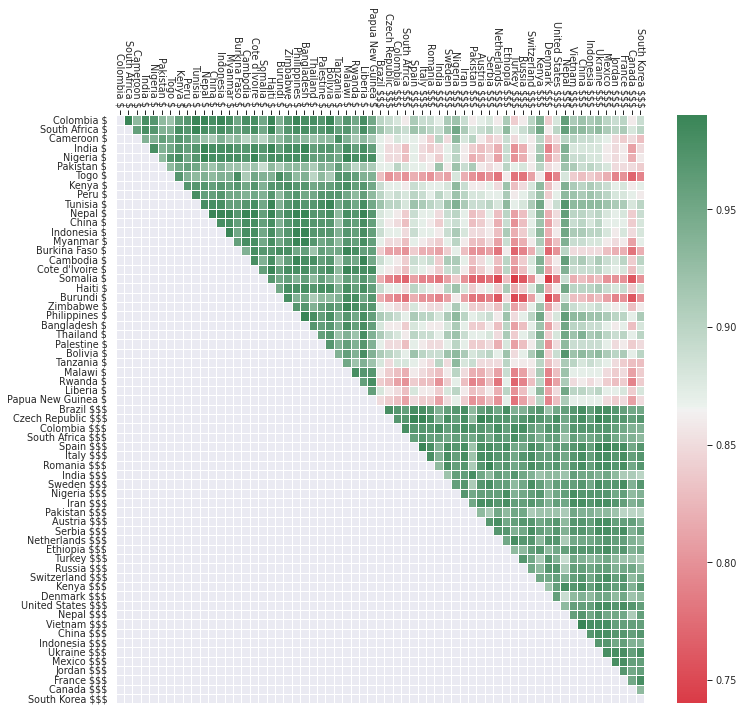

In [64]:
# Create a mask
mask = np.tril(np.ones_like(list_sim, dtype=bool))

a4_dims = (11, 10)
fig, ax = pyplot.subplots(figsize=a4_dims)
sns.set_theme(context='paper', font_scale=1.1)

cmap = sns.diverging_palette(10, 140, sep=1, l=50, center="light", as_cmap=True)
# color = ((0.8, 0.0, 0.0, 1.0), (0.0, 0.8, 0.0, 1.0))
# cmap = LinearSegmentedColormap.from_list('Custom', color, 2)
sns.heatmap(df, mask=mask, linewidth=1.0, cmap=cmap, xticklabels=True, yticklabels=True)
# sns.clustermap(df, mask=mask, linewidth=0.9, cmap=cmap)
ax.xaxis.tick_top()
plt.xticks(rotation=270)


# # Manually specify colorbar labelling after it's been generated
# colorbar = ax.collections[0].colorbar
# colorbar.set_ticks([0.7, 0.3])
# colorbar.set_ticklabels(['>=0.8', '<0.8'])

plt.tight_layout()
# plt.show()
plt.savefig('Images/extended_heatmap.pdf', bbox_inches='tight')

## Quantifying Diversity

In [81]:
!pip install sentence-transformers

Defaulting to user installation because normal site-packages is not writeable


In [82]:
from sentence_transformers import SentenceTransformer

model = SentenceTransformer('bert-base-nli-mean-tokens')

In [83]:
len(dict_name2avg_features.keys())

15385

In [85]:
query_list = []
for query in tqdm.tqdm(dict_name2avg_features.keys()):
    query = query.replace("bed_hq", "bed-hq")
    topic_query, country_query, income_level = query.split('_')
    if income_level == 'poor' or income_level == 'rich':
        query_list.append(query)

100%|██████████| 15385/15385 [00:00<00:00, 1632993.40it/s]


In [87]:
for k in tqdm.tqdm(range(16)):
    count = 500
    dict_topic_text_sim = {}
    query_list_ = query_list[count*k:count*(k+1)]
    
    for query in tqdm.tqdm(query_list_):
    
        emb_query = dict_name2avg_features[query]
        list_topics = []
        list_similarities = []

        for text, vis_emb in dict_name2avg_features.items():
            text = text.replace("bed_hq", "bed-hq")
            topic, country, income = text.split("_")
            #if topic != topic_query and country != country_query and income == "rich":
        #   if country == country_query:
        #         similarity = emb_query.cpu().numpy() @ vis_emb.cpu().numpy().T
            similarity = cos(emb_query, vis_emb)
            list_similarities.append([topic, country, similarity, income])

        list_similarities.sort(key=lambda x: x[2], reverse=True)        
        #print(list_similarities[1:11])
        list_topics = [sim[0] for sim in list_similarities[:11]]
        #print(list_topics)
        #print(country_query)


        sentences = list_topics
        #sentence_embeddings = [dict_topic2sentence_encode[top] for top in sentences]
        sentence_embeddings = model.encode(sentences)
        topic_sim = cosine_similarity([sentence_embeddings[0]], sentence_embeddings[1:])
        topic = "_".join([topic_query, country, income_level])
        dict_topic_text_sim[query] = topic_sim.flatten().tolist()
        print(query)
        print(len(dict_topic_text_sim))
        
    f = open(f"data/text_sim_dict/dict_topic_text_sim_{k+1}.pkl","wb")

    # write the python object (dict) to pickle file
    pickle.dump(dict_topic_text_sim,f)

    # close file
    f.close()        

  0%|          | 1/500 [00:04<37:12,  4.47s/it]

adding spices to food while cooking_Brazil_rich
1



  0%|          | 2/500 [00:08<33:43,  4.06s/it]

adding spices to food while cooking_Czech Republic_rich
2



  1%|          | 3/500 [00:12<32:43,  3.95s/it]

adding spices to food while cooking_Colombia_rich
3



  1%|          | 4/500 [00:15<32:04,  3.88s/it]

adding spices to food while cooking_South Africa_rich
4



  1%|          | 5/500 [00:19<31:38,  3.84s/it]

adding spices to food while cooking_Spain_rich
5



  1%|          | 6/500 [00:23<31:35,  3.84s/it]

adding spices to food while cooking_Italy_rich
6



  1%|▏         | 7/500 [00:27<31:21,  3.82s/it]

adding spices to food while cooking_Romania_rich
7


  0%|          | 0/16 [00:30<?, ?it/s]


KeyboardInterrupt: 

In [101]:
# Merge dictionaries
dict_path = '/home/jnwatu/Dollar_Street/Bridging_the_digital_divide/data/text_sim_dict'

dict_list = [f"data/text_sim_dict/{filename}" for filename in os.listdir(dict_path) if filename.split(".")[-1] == "pkl"]

In [103]:
dict_all = {}

for d in dict_list:
    file_to_read = open(d, "rb")
    temp  = pickle.load(file_to_read)
    dict_all = dict_all | temp
    
print(len(dict_all))

7760


In [177]:
# count of topics higher than 0.7 similarity

dict_sim_counter = {}

for query, sim_list in tqdm.tqdm(dict_all.items()):
    thresh_count = Counter(i > 0.7 for i in sim_list)
    dict_sim_counter[query] = thresh_count
    

100%|██████████| 7760/7760 [00:00<00:00, 371719.95it/s]


In [175]:
# per topic across all countries


dict_sim_allcountries = {}

for topic_ in list(data['topics'].unique()):
    simtopiclist_rich = []
    simtopiclist_poor = []
    for query, sim_list in tqdm.tqdm(dict_all.items()):
    #for query, sim_list in tqdm(dict_topic_text_sim_5.items()):
        query = query.replace("bed_hq", "bed-hq")
        topic, country, income = query.split("_")
        if topic_ == topic:
            if income == 'rich':
                simtopiclist_rich.extend(sim_list)
            if income == 'poor':
                simtopiclist_poor.extend(sim_list)
    richtopic = "_".join([topic_, "rich"])
    poortopic = "_".join([topic_, "poor"])
    dict_sim_allcountries[richtopic] = simtopiclist_rich
    dict_sim_allcountries[poortopic] = simtopiclist_poor


100%|██████████| 7760/7760 [00:00<00:00, 1766981.49it/s]


In [180]:
# per all countries

dict_sim_counter_all = {}

for query, sim_list in tqdm.tqdm(dict_sim_allcountries.items()):
    thresh_count = Counter(i > 0.7 for i in sim_list)
    dict_sim_counter_all[query] = thresh_count

100%|██████████| 540/540 [00:00<00:00, 89272.17it/s]


In [181]:
topic_list = []
rich_list_true = []
rich_list_false = []
poor_list_true = []
poor_list_false = []

for topic_ in tqdm.tqdm(list(data['topics'].unique())):
    keyrich = "_".join([topic_, "rich"])
    keypoor = "_".join([topic_, "poor"])
    topic_list.append(topic_)
    if keyrich in dict_sim_counter_all.keys():
        rich_list_true.append(dict_sim_counter_all[keyrich][True])
        rich_list_false.append(dict_sim_counter_all[keyrich][False])
    else:
        rich_list_true.append(0)
        rich_list_false.append(0)
    if keypoor in dict_sim_counter_all.keys():
        poor_list_true.append(dict_sim_counter_all[keypoor][True])
        poor_list_false.append(dict_sim_counter_all[keypoor][False])
    else:
        poor_list_true.append(0)
        poor_list_false.append(0)

100%|██████████| 270/270 [00:00<00:00, 586464.05it/s]


In [182]:
counter_sim_df = pd.DataFrame()
counter_sim_df['Topic'] = topic_list
counter_sim_df['Rich True'] = rich_list_true
counter_sim_df['Rich False'] = rich_list_false
counter_sim_df['Poor True'] = poor_list_true
counter_sim_df['Poor False'] = poor_list_false
counter_sim_df.head(10)

Topic  Rich True  Rich False  Poor True  \
0  adding spices to food while cooking         79          91          4   
1                               spices        218         102        127   
2                                visit        202          78         87   
3                                 salt        209         101        151   
4            taking a teaspoon of salt         22         158          0   
5                              cooking        196          44        184   
6                                bowls         35           5         10   
7                           dish racks        230          80        211   
8                              cutlery        284           6        200   
9                     cooking utensils        225          45        183   

   Poor False  
0           6  
1         173  
2         163  
3         129  
4          40  
5          46  
6          40  
7          59  
8          60  
9          87

In [183]:
# Most similar to topic for rich

counter_sim_df['Rich True'].sum()/ (counter_sim_df['Rich True'].sum() + counter_sim_df['Rich False'].sum())

0.6684620673848269

In [184]:
# Most dissimilar to topic for rich

counter_sim_df['Rich False'].sum()/ (counter_sim_df['Rich True'].sum() + counter_sim_df['Rich False'].sum())

0.33153793261517306

In [186]:
# Most similar to topic for poor

counter_sim_df['Poor True'].sum()/ (counter_sim_df['Poor True'].sum() + counter_sim_df['Poor False'].sum())

0.5299941072480848

In [187]:
# Most dissimilar to topic for poor

counter_sim_df['Poor False'].sum()/ (counter_sim_df['Poor True'].sum() + counter_sim_df['Poor False'].sum())

0.4700058927519151